In [1]:
import pandas as pd
renewable_data = pd.read_csv('/home/joseph/Downloads/Renewable.csv')
renewable_data_head = renewable_data.head()
renewable_data_info = renewable_data.info()
renewable_data_info
renewable_data_head,

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 196776 entries, 0 to 196775
Data columns (total 17 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   Time                    196776 non-null  object 
 1   Energy delta[Wh]        196776 non-null  int64  
 2   GHI                     196776 non-null  float64
 3   temp                    196776 non-null  float64
 4   pressure                196776 non-null  int64  
 5   humidity                196776 non-null  int64  
 6   wind_speed              196776 non-null  float64
 7   rain_1h                 196776 non-null  float64
 8   snow_1h                 196776 non-null  float64
 9   clouds_all              196776 non-null  int64  
 10  isSun                   196776 non-null  int64  
 11  sunlightTime            196776 non-null  int64  
 12  dayLength               196776 non-null  int64  
 13  SunlightTime/daylength  196776 non-null  float64
 14  weather_type        

(                  Time  Energy delta[Wh]  GHI  temp  pressure  humidity  \
 0  2017-01-01 00:00:00                 0  0.0   1.6      1021       100   
 1  2017-01-01 00:15:00                 0  0.0   1.6      1021       100   
 2  2017-01-01 00:30:00                 0  0.0   1.6      1021       100   
 3  2017-01-01 00:45:00                 0  0.0   1.6      1021       100   
 4  2017-01-01 01:00:00                 0  0.0   1.7      1020       100   
 
    wind_speed  rain_1h  snow_1h  clouds_all  isSun  sunlightTime  dayLength  \
 0         4.9      0.0      0.0         100      0             0        450   
 1         4.9      0.0      0.0         100      0             0        450   
 2         4.9      0.0      0.0         100      0             0        450   
 3         4.9      0.0      0.0         100      0             0        450   
 4         5.2      0.0      0.0         100      0             0        450   
 
    SunlightTime/daylength  weather_type  hour  month  
 0  

In [2]:
# 3. Get descriptive statistics for numerical columns
print("\nSummary statistics for numerical columns:")
print(renewable_data.describe())


Summary statistics for numerical columns:
       Energy delta[Wh]            GHI           temp       pressure  \
count     196776.000000  196776.000000  196776.000000  196776.000000   
mean         573.008228      32.596538       9.790521    1015.292780   
std         1044.824047      52.172018       7.995428       9.585773   
min            0.000000       0.000000     -16.600000     977.000000   
25%            0.000000       0.000000       3.600000    1010.000000   
50%            0.000000       1.600000       9.300000    1016.000000   
75%          577.000000      46.800000      15.700000    1021.000000   
max         5020.000000     229.200000      35.800000    1047.000000   

            humidity     wind_speed        rain_1h        snow_1h  \
count  196776.000000  196776.000000  196776.000000  196776.000000   
mean       79.810566       3.937746       0.066035       0.007148   
std        15.604459       1.821694       0.278913       0.069710   
min        22.000000       0.000

## Overview of the Data

This data is a time series data related to energy consumption and weather conditions.
The key measurements that are being collected include the following:

### Key Features and Observations

1. **Energy Delta [Wh]**:
   - Represents energy consumption/generation changes in watt-hours
   - Highly variable (standard deviation > mean)
   - Many zero values (25th and 50th percentiles are 0)
   - Maximum of 5020 Wh shows significant peaks

2. **Weather Variables**:
   - **GHI (Global Horizontal Irradiance)**: Solar radiation measurement with many zero values (night hours)
   - **Temperature**: Ranges from -16.6°C to 35.8°C, suggesting a temperate climate with seasonal variation
   - **Precipitation**: Both rain and snow present but relatively infrequent (low means)
   - **Cloud Cover**: Bimodal distribution with many completely clear or completely overcast days

3. **Sunlight Metrics**:
   - **isSun**: Binary variable (0/1) indicating daylight
   - **sunlightTime**: Minutes of sunlight, highly variable
   - **dayLength**: Minutes of daylight varies seasonally (450-1020 minutes)
   - **SunlightTime/daylength**: Ratio showing actual sunlight vs. potential daylight

4. **Temporal Variables**:
   - Hourly and monthly data available for seasonal analysis
   - **weather_type**: Categorical variable (1-5) likely representing different weather conditions

### Interesting Patterns

1. **Energy Consumption Distribution**:
   - The large gap between median (0) and mean (~573 Wh) suggests right-skewed distribution
   - 75% of values are ≤577 Wh, with occasional large spikes up to 5020 Wh

2. **Weather Patterns**:
   - High average humidity (79.8%) with moderate wind speeds
   - Cloud coverage is high on average (66%)
   - Precipitation is sporadic (mostly 0, with occasional significant events)

3. **Seasonality**:
   - Day length varies from 7.5 hours to 17 hours, indicating mid-to-high latitude location
   - Full year of data available (months 1-12)

This dataset appears well-suited for predictive modeling of energy consumption based on weather conditions and temporal factors.
WE  will be use Conditional- Wassereteine Gan for probabilistic regression especially to forecast energy consumptionn
getting uncertainities and confidence intervals that will be useful for energy consumtption paterns. This this data gives us 
a purpose to get god resukts as it have key parameteres that we can condition i.e weather conditons and temporal patterns like time 
useful in this researcch.

In [4]:

print("\nExamining each column individually:")
for column in renewable_data.columns:
    print(f"\n--- Column: {column} ---")
    print(f"Data type: {renewable_data[column].dtype}")
    if pd.api.types.is_numeric_dtype(renewable_data[column]):
        print(f"Min: {renewable_data[column].min()}")
        print(f"Max: {renewable_data[column].max()}")
        print(f"Mean: {renewable_data[column].mean():.2f}")
        print(f"Most common values:")
        print(renewable_data[column].value_counts().head(3))
    else:
        print(f"Number of unique values: {renewable_data[column].nunique()}")
        print("Sample values:")
        print(renewable_data[column].head(3))


Examining each column individually:

--- Column: Time ---
Data type: object
Number of unique values: 196776
Sample values:
0    2017-01-01 00:00:00
1    2017-01-01 00:15:00
2    2017-01-01 00:30:00
Name: Time, dtype: object

--- Column: Energy delta[Wh] ---
Data type: int64
Min: 0
Max: 5020
Mean: 573.01
Most common values:
0    100850
2       260
5       254
Name: Energy delta[Wh], dtype: int64

--- Column: GHI ---
Data type: float64
Min: 0.0
Max: 229.2
Mean: 32.60
Most common values:
0.0    95044
0.1      555
0.3      419
Name: GHI, dtype: int64

--- Column: temp ---
Data type: float64
Min: -16.6
Max: 35.8
Mean: 9.79
Most common values:
4.8    1500
3.8    1396
5.8    1372
Name: temp, dtype: int64

--- Column: pressure ---
Data type: int64
Min: 977
Max: 1047
Mean: 1015.29
Most common values:
1018    9372
1016    9220
1015    9108
Name: pressure, dtype: int64

--- Column: humidity ---
Data type: int64
Min: 22
Max: 100
Mean: 79.81
Most common values:
94    8096
93    7856
95    7764
Nam



### 1. **Time**

* **Data type**: `datetime64[ns]` (timestamp with nanosecond precision).
* **Unique Values**: There are 196,776 distinct timestamps.
* **Sample Values**: Shows 15-minute intervals starting from January 1st, 2017.
* **Insight**: This column tracks time in precise intervals, likely used for time-series analysis or tracking environmental data at specific times.

### 2. **Energy delta\[Wh]**

* **Data type**: `int64` (integer values).
* **Min and Max**: The energy change ranges from 0 to 5020 Wh.
* **Mean**: The average energy delta is 573 Wh, suggesting moderate energy changes.
* **Most Common Values**: 0 (no energy change), 2, and 5 are frequent. This indicates many intervals with little to no energy fluctuation.
* **Insight**: The large number of 0 values might indicate periods of no energy generation or consumption.

### 3. **GHI (Global Horizontal Irradiance)**

* **Data type**: `float64` (floating-point numbers).
* **Min and Max**: GHI ranges from 0.0 to 229.2, indicating significant variability in solar radiation.
* **Mean**: The average GHI is 32.60, showing moderate solar exposure.
* **Most Common Values**: The most common value is 0 (no solar radiation), followed by small amounts of radiation (0.1 and 0.3).
* **Insight**: A large proportion of the data has no solar radiation, which may reflect nighttime or overcast conditions.

### 4. **Temp (Temperature in °C)**

* **Data type**: `float64`.
* **Min and Max**: Temperatures range from -16.6°C to 35.8°C, representing extreme cold to warm conditions.
* **Mean**: The average temperature is 9.79°C.
* **Most Common Values**: Values near 4.8°C, 3.8°C, and 5.8°C are common.
* **Insight**: The data likely represents a temperate climate, with many readings clustered in a narrow range of temperatures.

### 5. **Pressure (Atmospheric Pressure in hPa)**

* **Data type**: `int64`.
* **Min and Max**: Atmospheric pressure ranges from 977 hPa to 1047 hPa.
* **Mean**: The average is 1015.29 hPa.
* **Most Common Values**: 1018, 1016, and 1015 are frequent, indicating stable pressure conditions.
* **Insight**: The dataset likely represents a region with stable atmospheric pressure.

### 6. **Humidity (%)**

* **Data type**: `int64`.
* **Min and Max**: Humidity ranges from 22% to 100%.
* **Mean**: The average is 79.81%, indicating relatively high humidity.
* **Most Common Values**: 94%, 93%, and 95% are common, suggesting periods of high humidity.
* **Insight**: This dataset likely comes from an area with generally high humidity.

### 7. **Wind Speed (m/s)**

* **Data type**: `float64`.
* **Min and Max**: Wind speed ranges from 0.0 to 14.3 m/s.
* **Mean**: The average wind speed is 3.94 m/s.
* **Most Common Values**: Wind speeds of 2.2 m/s, 3.2 m/s, and 2.4 m/s are most frequent.
* **Insight**: Most of the data represents light to moderate winds.

### 8. **Rain (Rainfall in 1 hour, mm)**

* **Data type**: `float64`.
* **Min and Max**: Rainfall ranges from 0.0 to 8.09 mm per hour.
* **Mean**: The average rainfall is 0.07 mm.
* **Most Common Values**: The most common value is 0.00 mm, indicating mostly dry conditions.
* **Insight**: There is very little rainfall in most records, suggesting mostly dry weather.

### 9. **Snow (Snowfall in 1 hour, cm)**

* **Data type**: `float64`.
* **Min and Max**: Snowfall ranges from 0.0 to 2.82 cm.
* **Mean**: Snowfall is quite rare, with an average of 0.01 cm.
* **Most Common Values**: 0 cm is overwhelmingly common, indicating no snowfall most of the time.
* **Insight**: Snow events are very infrequent in this dataset.

### 10. **Clouds (Percentage of Cloud Cover)**

* **Data type**: `int64`.
* **Min and Max**: Cloud cover ranges from 0% to 100%.
* **Mean**: The average cloud cover is 65.97%.
* **Most Common Values**: 100%, 0%, and 99% are most common, suggesting either fully cloudy or clear skies.
* **Insight**: The data shows frequent cloud cover, but with a considerable number of clear or overcast conditions.

### 11. **isSun (Binary indicator of sunny conditions)**

* **Data type**: `int64`.
* **Min and Max**: The value is either 0 (not sunny) or 1 (sunny).
* **Mean**: 52% of the data points are sunny.
* **Most Common Values**: Sunny (1) occurs more often than not.
* **Insight**: This indicates that nearly half the data points reflect sunny weather.

### 12. **Sunlight Time (Minutes of Sunlight)**

* **Data type**: `int64`.
* **Min and Max**: Sunlight time ranges from 0 to 1020 minutes.
* **Mean**: The average is 211.72 minutes of sunlight.
* **Most Common Values**: 0 minutes (no sunlight) is the most common, followed by 240 and 450 minutes.
* **Insight**: Sunlight duration varies greatly, with many records showing no sunlight.

### 13. **Day Length (Minutes of Daylight)**

* **Data type**: `int64`.
* **Min and Max**: Day length ranges from 450 to 1020 minutes.
* **Mean**: The average day length is 748.64 minutes (\~12.5 hours).
* **Most Common Values**: 1020 minutes (the longest day) is most frequent.
* **Insight**: This suggests data was collected in a region with significant variation in day length, such as higher latitudes.

### 14. **Sunlight Time / Day Length (Ratio of Sunlight Time to Day Length)**

* **Data type**: `float64`.
* **Min and Max**: The ratio ranges from 0.0 to 1.0.
* **Mean**: The average ratio is 0.27.
* **Most Common Values**: 0.00 (no sunlight) is most common, followed by 1.00 (full sunlight).
* **Insight**: A significant number of observations show either no sunlight or full sunlight relative to day length.

### 15. **Weather Type**

* **Data type**: `int64`.
* **Min and Max**: Weather types range from 1 to 5.
* **Mean**: The most common weather type is 4, likely indicating a cloudy or stormy condition.
* **Most Common Values**: 4 (likely cloudy) is most common, followed by types 2 and 3.
* **Insight**: The data is dominated by cloudy or variable weather conditions.

### 16. **Hour**

* **Data type**: `int64`.
* **Min and Max**: Hours range from 0 to 23 (24-hour format).
* **Mean**: The average hour is 11.5, indicating midday or afternoon times.
* **Most Common Values**: Hours 0, 10, and 17 are frequent.
* **Insight**: This suggests frequent data collection during specific times of the day.

### 17. **Month**

* **Data type**: `int64`.
* **Min and Max**: Months range from 1 (January) to 12 (December).
* **Mean**: The average month is around 6.3 (June).
* **Most Common Values**: March, May, and July are the most common months.
* **Insight**: The data likely covers multiple seasons, with a focus on late spring to summer months.

### General Insights:

* **Weather Patterns**: The dataset reflects mostly moderate conditions with frequent dry and sunny weather, though there is some cloud cover.
* **Time of Day**: Data points are spread across all times of the day, with a concentration around midday to early afternoon.
* **Geographic Region**: The dataset likely represents a region with seasonal variations in daylight and weather, possibly in temperate or subtropical zones.


In [5]:
print("\nMissing values in each column:")
print(renewable_data.isnull().sum())


Missing values in each column:
Time                      0
Energy delta[Wh]          0
GHI                       0
temp                      0
pressure                  0
humidity                  0
wind_speed                0
rain_1h                   0
snow_1h                   0
clouds_all                0
isSun                     0
sunlightTime              0
dayLength                 0
SunlightTime/daylength    0
weather_type              0
hour                      0
month                     0
dtype: int64


In [6]:
print("\nCorrelation of 'Energy delta[Wh]' with other features:")
numerical_columns = renewable_data.select_dtypes(include=['number']).columns
correlations = renewable_data[numerical_columns].corrwith(renewable_data['Energy delta[Wh]'])
print(correlations.sort_values(ascending=False))


Correlation of 'Energy delta[Wh]' with other features:
Energy delta[Wh]          1.000000
GHI                       0.914619
isSun                     0.526952
sunlightTime              0.437296
SunlightTime/daylength    0.402523
temp                      0.378554
dayLength                 0.280695
pressure                  0.115219
wind_speed                0.029385
month                    -0.049307
snow_1h                  -0.050914
rain_1h                  -0.059881
hour                     -0.080877
weather_type             -0.170046
clouds_all               -0.190241
humidity                 -0.544407
dtype: float64


The strongest influences on energy production are solar radiation (GHI), sunny conditions, sunlight time, and temperature.

Negative correlations with energy production are mainly linked to weather conditions such as high humidity, cloud cover, and specific weather types (likely cloudy or rainy).

Variables like wind speed, atmospheric pressure, and snow have minimal impact on energy production.

# Data Visualization

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
import matplotlib.dates as mdates
from matplotlib.ticker import MaxNLocator
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Set the style for plots
plt.style.use('seaborn-whitegrid') if 'seaborn-whitegrid' in plt.style.available else plt.style.use('default')
sns.set_palette("viridis")
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['axes.grid'] = True

In [8]:
# Display basic info about the data
print("Data shape:", renewable_data.shape)
renewable_data.head()

Data shape: (196776, 17)


,Time,Energy delta[Wh],GHI,temp,pressure,humidity,wind_speed,rain_1h,snow_1h,clouds_all,isSun,sunlightTime,dayLength,SunlightTime/daylength,weather_type,hour,month
0,2017-01-01 00:00:00,0,0.0,1.6,1021,100,4.9,0.0,0.0,100,0,0,450,0.0,4,0,1
1,2017-01-01 00:15:00,0,0.0,1.6,1021,100,4.9,0.0,0.0,100,0,0,450,0.0,4,0,1
2,2017-01-01 00:30:00,0,0.0,1.6,1021,100,4.9,0.0,0.0,100,0,0,450,0.0,4,0,1
3,2017-01-01 00:45:00,0,0.0,1.6,1021,100,4.9,0.0,0.0,100,0,0,450,0.0,4,0,1
4,2017-01-01 01:00:00,0,0.0,1.7,1020,100,5.2,0.0,0.0,100,0,0,450,0.0,4,1,1


In [10]:
renewable_data['Time'] = pd.to_datetime(renewable_data['Time'], errors='coerce')

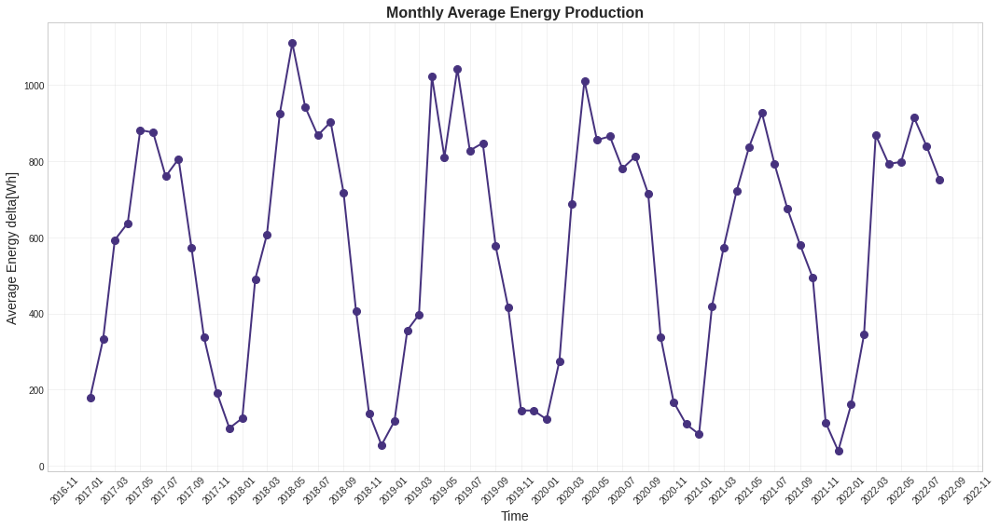

In [11]:
plt.figure(figsize=(15, 8))
# Plot the average energy production by month
monthly_energy = renewable_data.groupby(renewable_data['Time'].dt.strftime('%Y-%m')).agg({
    'Energy delta[Wh]': 'mean'
}).reset_index()
monthly_energy['Time'] = pd.to_datetime(monthly_energy['Time'])

plt.plot(monthly_energy['Time'], monthly_energy['Energy delta[Wh]'], 
         marker='o', linestyle='-', linewidth=2, markersize=8)

plt.title('Monthly Average Energy Production', fontsize=16, fontweight='bold')
plt.xlabel('Time', fontsize=14)
plt.ylabel('Average Energy delta[Wh]', fontsize=14)
plt.grid(True, alpha=0.3)

# Format x-axis to show months
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=2))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The graph depicts the monthly average energy production, with seasonal fluctuations in energy output over the years.

Energy production peaks during the warmer months, particularly from late spring to early summer, reflecting a higher availability of sunlight or favorable weather conditions.

Conversely, energy production drops significantly during the colder months, from late fall to early spring, likely due to reduced sunlight or adverse weather conditions. These cycles repeat predictably, suggesting a seasonal pattern in energy generation. 

The data's consistent high and low points emphasize the dependency of energy production on environmental factors, likely indicating the influence of solar power or similar renewable energy sources.


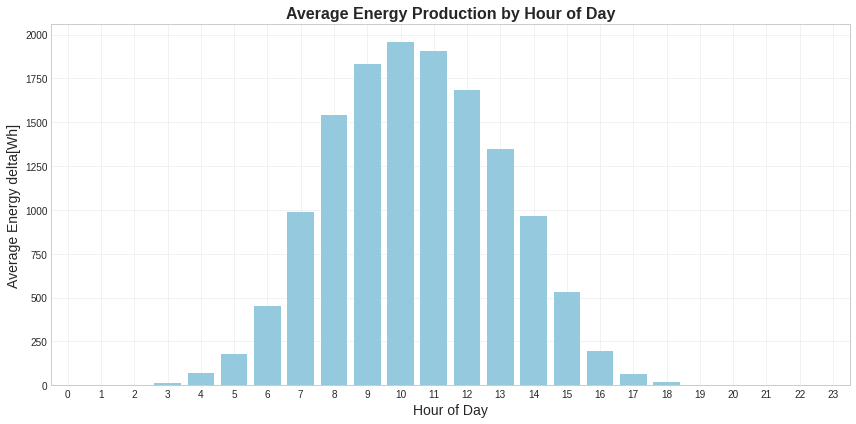

In [12]:
hourly_energy = renewable_data.groupby('hour').agg({
    'Energy delta[Wh]': 'mean'
}).reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(x='hour', y='Energy delta[Wh]', data=hourly_energy, color='skyblue')
plt.title('Average Energy Production by Hour of Day', fontsize=16, fontweight='bold')
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Average Energy delta[Wh]', fontsize=14)
plt.grid(True, alpha=0.3)
plt.xticks(range(0, 24))
plt.tight_layout()
plt.show()

The graph shows how energy production changes throughout the day. The highest energy production happens between **9:00 AM and 12:00 PM**, with the peak around **10:00 AM to 12:00 PM**, likely because of the best sunlight during those hours. The energy starts to rise early in the morning, around **6:00 AM**, as the sun comes up, and continues to increase until it hits the peak. After that, energy production starts to drop in the afternoon and evening, especially after **3:00 PM**. By the time it’s evening (**5:00 PM onward**), the energy production is very low, as there’s less sunlight. This pattern is typical for **solar energy**, which relies on the sun for power.


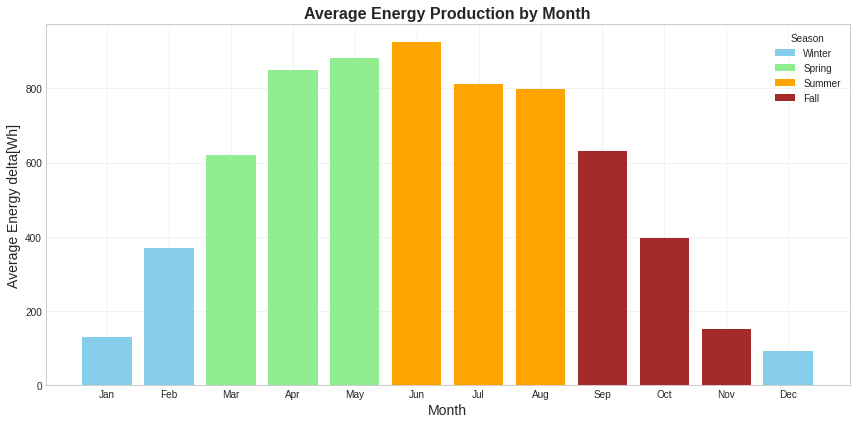

In [13]:
monthly_avg = renewable_data.groupby('month').agg({
    'Energy delta[Wh]': 'mean'
}).reset_index()

# Create a color map for seasons
month_to_season = {
    1: 'Winter', 2: 'Winter', 3: 'Spring', 
    4: 'Spring', 5: 'Spring', 6: 'Summer',
    7: 'Summer', 8: 'Summer', 9: 'Fall', 
    10: 'Fall', 11: 'Fall', 12: 'Winter'
}

season_colors = {
    'Winter': 'skyblue', 
    'Spring': 'lightgreen', 
    'Summer': 'orange', 
    'Fall': 'brown'
}

# Add season and color to the dataframe
monthly_avg['season'] = monthly_avg['month'].map(month_to_season)
monthly_avg['color'] = monthly_avg['season'].map(season_colors)

plt.figure(figsize=(12, 6))
plt.bar(monthly_avg['month'], monthly_avg['Energy delta[Wh]'], color=monthly_avg['color'])

plt.title('Average Energy Production by Month', fontsize=16, fontweight='bold')
plt.xlabel('Month', fontsize=14)
plt.ylabel('Average Energy delta[Wh]', fontsize=14)
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True, alpha=0.3)

# Add a legend for seasons
from matplotlib.patches import Patch
legend_elements = [Patch(facecolor=color, label=season) 
                   for season, color in season_colors.items()]
plt.legend(handles=legend_elements, title='Season')

plt.tight_layout()
plt.show()

The graph shows **average energy production by month**, with **months** on the x-axis and **average energy delta (in Watt-hours)** on the y-axis. The energy production is color-coded by season:

* **Winter (blue)**: Energy production is low during **January** and **December**, typical of colder months when sunlight is less available.
* **Spring (green)**: The production increases in **March** and peaks in **April** and **May**, as sunlight becomes more abundant during spring.
* **Summer (orange)**: The highest energy production occurs in **June**, followed by a slight drop in **July** and **August**, which still shows relatively high production.
* **Fall (red)**: Energy production decreases significantly in **September**, **October**, and **November**, likely due to reduced sunlight as the weather cools down.

This clearly depicts the relationship between energy production and seasonal changes, with the highest output during summer and spring, and the lowest in winter and fall.


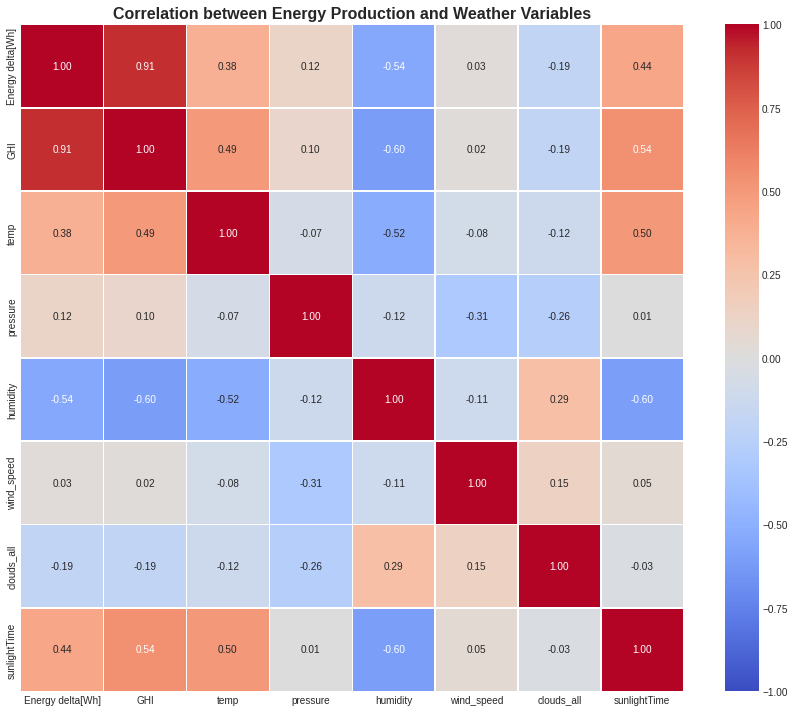

In [14]:
correlation_columns = ['Energy delta[Wh]', 'GHI', 'temp', 'pressure', 
                       'humidity', 'wind_speed', 'clouds_all', 'sunlightTime']
correlation_matrix = renewable_data[correlation_columns].corr()

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, 
            fmt='.2f', linewidths=0.5)
plt.title('Correlation between Energy Production and Weather Variables', 
          fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

The heatmap shows how different weather factors are related to energy production. Here’s a simple explanation of the key points:

* **Energy production** (Energy delta) is strongly connected to **sunlight** (GHI). More sunlight means more energy is produced.
* **Humidity** and **cloud cover** reduce energy production. When it's more humid or cloudy, less energy is made.
* **Longer sunlight time** also leads to more energy being produced, as expected.
* **Temperature** has a small positive effect on energy production, but it’s not as strong as sunlight.
* **Wind speed**, **pressure**, and **cloud cover** don’t seem to have a big impact on energy production.

In short, **sunlight** is the most important factor for generating energy, while **humidity** and **cloud cover** reduce it.


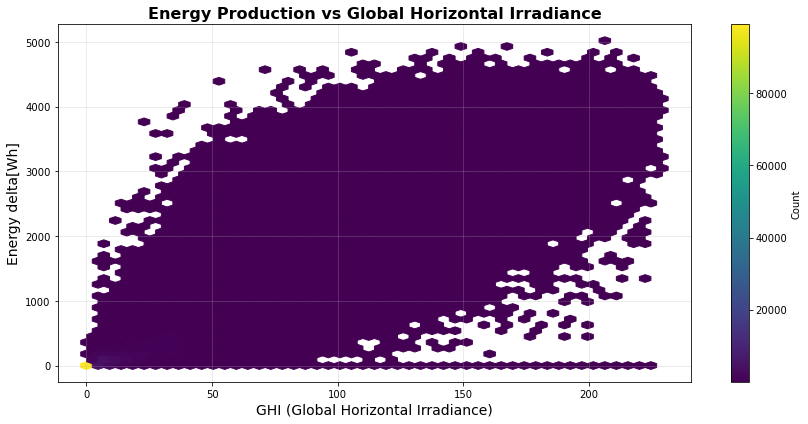

In [67]:
# 5. Energy Production vs GHI (Global Horizontal Irradiance)
# ---------------------------------------------------------

plt.figure(figsize=(12, 6))

# Create hexbin plot for density visualization
plt.hexbin(renewable_data['GHI'], renewable_data['Energy delta[Wh]'], 
           gridsize=50, cmap='viridis', mincnt=1)
plt.colorbar(label='Count')

plt.title('Energy Production vs Global Horizontal Irradiance', fontsize=16, fontweight='bold')
plt.xlabel('GHI (Global Horizontal Irradiance)', fontsize=14)
plt.ylabel('Energy delta[Wh]', fontsize=14)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

Energy production increases as GHI increases: There is a clear trend that higher GHI values (more sunlight) are associated with higher energy production, especially as you move towards the right side of the graph.

The density of points is very high in the lower GHI range, where the energy production is generally low. This suggests that during times of low sunlight (low GHI), energy production remains low, with many instances where little or no energy is produced.

As GHI values increase, energy production rises, and the points spread out across the graph, indicating higher levels of energy generation.

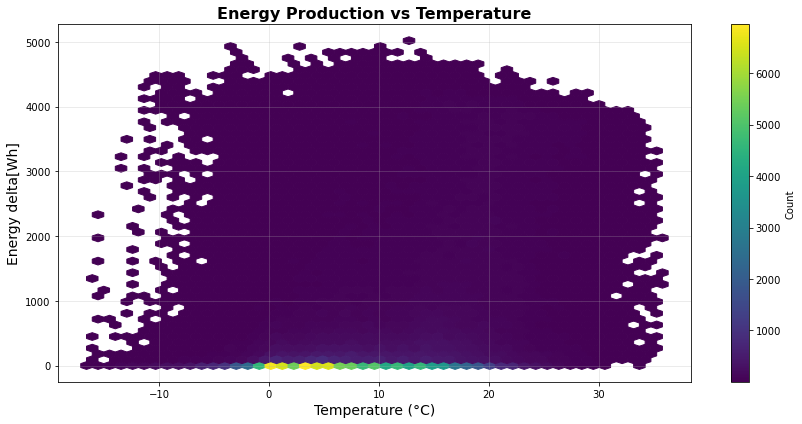

In [68]:
# 6. Energy Production vs Temperature
# ----------------------------------

plt.figure(figsize=(12, 6))

# Create hexbin plot for density visualization
plt.hexbin(renewable_data['temp'], renewable_data['Energy delta[Wh]'], 
           gridsize=50, cmap='viridis', mincnt=1)
plt.colorbar(label='Count')

plt.title('Energy Production vs Temperature', fontsize=16, fontweight='bold')
plt.xlabel('Temperature (°C)', fontsize=14)
plt.ylabel('Energy delta[Wh]', fontsize=14)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

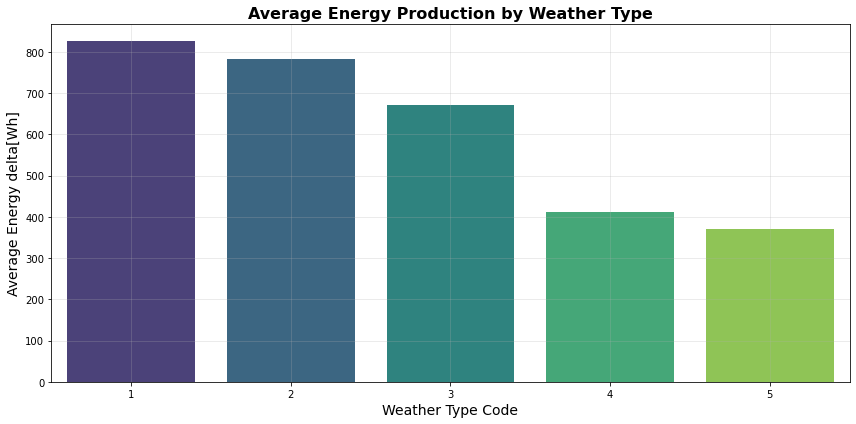

In [70]:
# 7. Energy Production by Weather Type
# -----------------------------------
import seaborn as sns
# Get the unique weather types and their average energy production
weather_energy = renewable_data.groupby('weather_type').agg({
    'Energy delta[Wh]': 'mean'
}).reset_index().sort_values(by='Energy delta[Wh]', ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(x='weather_type', y='Energy delta[Wh]', data=weather_energy, palette='viridis')
plt.title('Average Energy Production by Weather Type', fontsize=16, fontweight='bold')
plt.xlabel('Weather Type Code', fontsize=14)
plt.ylabel('Average Energy delta[Wh]', fontsize=14)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

In [74]:
# Import necessary libraries
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots
renewable_data['Time'] = pd.to_datetime(renewable_data['Time'])

# Create a 7-day rolling average for energy production
renewable_data['7_day_avg'] = renewable_data['Energy delta[Wh]'].rolling(window=7*24*4).mean()  # Assuming 15-minute intervals

# Resample data to daily for better visualization
daily_data = renewable_data.resample('D', on='Time').agg({
    'Energy delta[Wh]': 'sum',
    '7_day_avg': 'mean',
    'GHI': 'mean',
    'temp': 'mean'
}).reset_index()

# Create interactive plot with Plotly
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(
        x=daily_data['Time'],
        y=daily_data['Energy delta[Wh]'],
        name="Daily Energy Production",
        line=dict(color='royalblue')
    )
)

fig.add_trace(
    go.Scatter(
        x=daily_data['Time'],
        y=daily_data['7_day_avg'],
        name="7-Day Average",
        line=dict(color='red', width=2, dash='dash')
    )
)

fig.add_trace(
    go.Scatter(
        x=daily_data['Time'],
        y=daily_data['GHI'],
        name="Average GHI",
        line=dict(color='orange')
    ),
    secondary_y=True,
)

fig.update_layout(
    title="Energy Production Over Time with 7-Day Moving Average",
    xaxis_title="Date",
    yaxis_title="Energy Production (Wh)",
    yaxis2_title="Global Horizontal Irradiance (GHI)",
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)

fig.show()


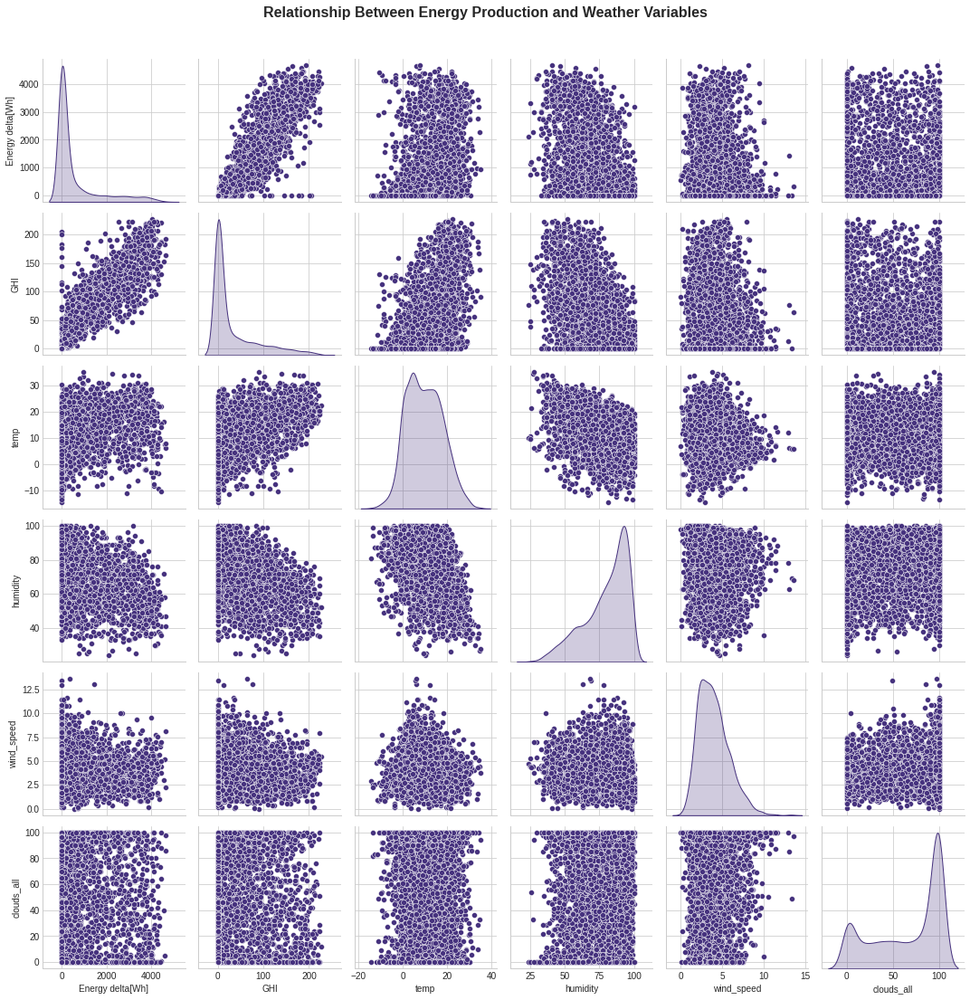

In [20]:
scatter_columns = ['Energy delta[Wh]', 'GHI', 'temp', 'humidity', 'wind_speed', 'clouds_all']
sns.pairplot(renewable_data[scatter_columns].sample(5000), diag_kind='kde')  # Sample 5000 points for better performance
plt.suptitle('Relationship Between Energy Production and Weather Variables', 
             fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

### Weather and Energy Production Relationships

Solar radiation (GHI) shows the strongest positive connection with energy production - more sunlight clearly means more energy. Cloud cover has the opposite effect, with high cloud coverage dramatically reducing energy output. Temperature affects energy in a more complex way, with best production occurring at moderate temperatures (10-25°C). Wind speed has a modest positive effect on energy production. Humidity doesn't show a clear linear pattern, though extreme humidity seems to limit peak energy generation. These relationships explain why predicting energy production requires sophisticated models like your WGAN-GP approach that can handle these complex, interconnected patterns.

In [15]:

fig = px.scatter_3d(
    renewable_data.sample(10000),  # Sample for better performance
    x='GHI',
    y='temp',
    z='Energy delta[Wh]',
    color='month',
    opacity=0.7,
    title='3D Visualization: Energy Production vs GHI vs Temperature'
)

fig.update_layout(
    scene=dict(
        xaxis_title='Global Horizontal Irradiance (GHI)',
        yaxis_title='Temperature (°C)',
        zaxis_title='Energy Production (Wh)'
    )
)

fig.show()

<Figure size 1008x576 with 0 Axes>

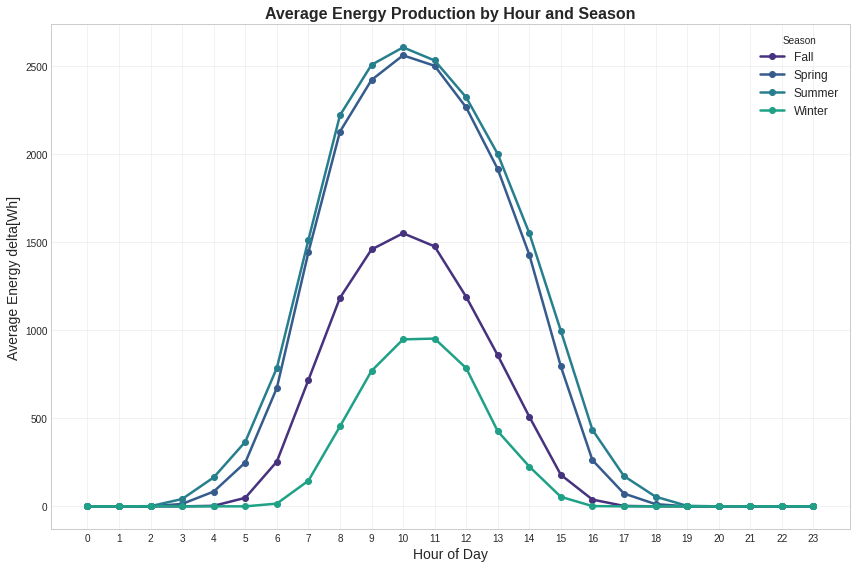

In [16]:

hourly_seasonal = renewable_data.copy()
hourly_seasonal['season'] = hourly_seasonal['month'].map(month_to_season)
hourly_seasonal_avg = hourly_seasonal.groupby(['hour', 'season']).agg({
    'Energy delta[Wh]': 'mean'
}).reset_index()

# Pivot the data for easier plotting
hourly_seasonal_pivot = hourly_seasonal_avg.pivot(index='hour', columns='season', values='Energy delta[Wh]')

plt.figure(figsize=(14, 8))
hourly_seasonal_pivot.plot(kind='line', marker='o', linewidth=2.5)

plt.title('Average Energy Production by Hour and Season', fontsize=16, fontweight='bold')
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Average Energy delta[Wh]', fontsize=14)
plt.grid(True, alpha=0.3)
plt.xticks(range(0, 24))
plt.legend(title='Season', fontsize=12)
plt.tight_layout()
plt.show()

Summer: The highest energy production, peaking at about 2500 Wh around midday (12:00 PM). This is because summer typically has longer days and higher solar radiation.

Spring: The energy production in Spring peaks at a lower value (~2000 Wh) and occurs slightly later in the day compared to Summer.

Fall: The energy production in Fall is somewhat lower (~1500 Wh), peaking in the late morning hours (around 9-11 AM), indicating that the solar irradiance during Fall is moderate.

Winter: Winter shows the lowest energy production, peaking at around 12 PM, but the overall energy is much lower than other seasons, hovering below 1000 Wh. This reflects shorter days and lower solar energy availability in Winter.

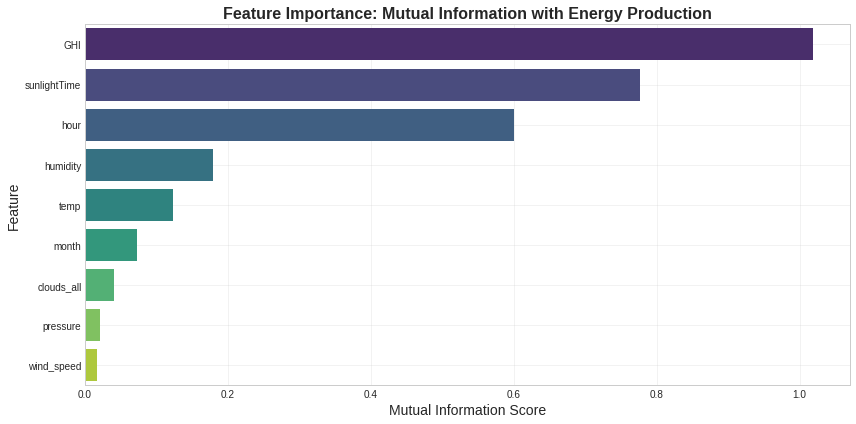

In [17]:
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import mutual_info_regression

# Select features for analysis
features = ['GHI', 'temp', 'pressure', 'humidity', 'wind_speed', 
           'clouds_all', 'sunlightTime', 'hour', 'month']

X = renewable_data[features]
y = renewable_data['Energy delta[Wh]']

# Calculate mutual information
mi_scores = mutual_info_regression(X, y)
mi_df = pd.DataFrame({'Feature': features, 'Mutual Information': mi_scores})
mi_df = mi_df.sort_values(by='Mutual Information', ascending=False)

plt.figure(figsize=(12, 6))
sns.barplot(x='Mutual Information', y='Feature', data=mi_df, palette='viridis')
plt.title('Feature Importance: Mutual Information with Energy Production', 
          fontsize=16, fontweight='bold')
plt.xlabel('Mutual Information Score', fontsize=14)
plt.ylabel('Feature', fontsize=14)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

The GHI feature is by far the most important in predicting energy production, followed by sunlightTime and hour. Environmental conditions such as humidity and temperature also play a role but are less critical.

Features like month, clouds_all, pressure, and wind_speed have relatively low importance in determining energy production, suggesting they are not as impactful in this analysis.

In [18]:
renewable_data['Time'] = pd.to_datetime(renewable_data['Time'])
renewable_data['rolling_mean'] = renewable_data['Energy delta[Wh]'].rolling(window=24*4).mean()  # 24 hours window
renewable_data['rolling_std'] = renewable_data['Energy delta[Wh]'].rolling(window=24*4).std()
renewable_data['rolling_std'] = renewable_data['rolling_std'].fillna(0)
renewable_data.loc[renewable_data['rolling_std'] == 0, 'rolling_std'] = 0.001  # Small value to avoid division by zero
renewable_data['upper_bound'] = renewable_data['rolling_mean'] + 3*renewable_data['rolling_std']
renewable_data['lower_bound'] = renewable_data['rolling_mean'] - 3*renewable_data['rolling_std']
renewable_data['is_anomaly'] = ((renewable_data['Energy delta[Wh]'] > renewable_data['upper_bound']) | 
                              (renewable_data['Energy delta[Wh]'] < renewable_data['lower_bound']))
sample_period = renewable_data.loc['2017-06-01':'2017-06-07']
anomaly_count = sample_period['is_anomaly'].sum()
print(f"Number of anomalies detected in sample: {anomaly_count}")

Number of anomalies detected in sample: 0
